In [1]:
import os
import re
import warnings
import pandas as pd
import numpy as np
import anndata as ad
import scanpy as sc
import seaborn as sns
import matplotlib.pyplot as plt
from matplotlib import colormaps
from matplotlib.lines import Line2D
from matplotlib.colors import to_hex
from glimmer.model import train_neighbor_weights, set_seed
from glimmer.utils import spatial_smooth

warnings.filterwarnings("ignore", category=SyntaxWarning)
warnings.filterwarnings('ignore', category=UserWarning)
warnings.simplefilter(action='ignore', category=FutureWarning)
%config InlineBackend.figure_format = 'retina'

In [ ]:
# Download datasets
# from copy import copy
# from squidpy.datasets._utils import AMetadata
# _codex_mouse_spleen = AMetadata(
#     name="codex_mouse_spleen",
#     doc_header="Pre-processed CODEX dataset of mouse spleen from `Goltsev et al "
#     "<https://doi.org/10.1016/j.cell.2018.07.010>`__.",
#     shape=(707474, 29),
#     url="https://figshare.com/ndownloader/files/38538101",
# )
# for name, var in copy(locals()).items():
#     if isinstance(var, AMetadata):
#         var._create_function(name, globals())
# adata = codex_mouse_spleen()  
# adata.write("adata.h5ad")

In [2]:
# Define directory path and name
main_path = '/data/qiyu/spatialRegion/'
dir_path = main_path + "data/codex/codex_mouse_spleen"
fig_path = main_path + 'figures/SVG/'
plt.rcParams['svg.fonttype'] = 'none'
plt.rcParams['font.family'] = 'DejaVu Sans' 

In [3]:
def check_spatial_overlap(slice1, slice2):
    x1_min, x1_max = slice1[:, 0].min(), slice1[:, 0].max()
    y1_min, y1_max = slice1[:, 1].min(), slice1[:, 1].max()
    x2_min, x2_max = slice2[:, 0].min(), slice2[:, 0].max()
    y2_min, y2_max = slice2[:, 1].min(), slice2[:, 1].max()
    overlap_x = (x1_min <= x2_max) and (x2_min <= x1_max)
    overlap_y = (y1_min <= y2_max) and (y2_min <= y1_max)
    return overlap_x and overlap_y

def offset_coordinates(base_slice, target_slice, x_offset=0, y_offset=0):
    base_x_max = base_slice[:, 0].max()
    base_y_max = base_slice[:, 1].max()
    x_shift = base_x_max - target_slice[:, 0].min() + x_offset
    y_shift = base_y_max - target_slice[:, 1].min() + y_offset
    return target_slice.copy() + np.array([x_shift, y_shift])

def integrate_slices(slices, x_offset=0, y_offset=0):
    adjusted_slices = []
    prev_x_max = None
    prev_y_max = None
    for i, cur in enumerate(slices):
        if i == 0:
            adjusted = cur.copy()
        else:
            x_shift = prev_x_max - cur[:, 0].min() + x_offset
            y_shift = prev_y_max - cur[:, 1].min() + y_offset
            adjusted = cur.copy() + np.array([x_shift, y_shift])
        prev_x_max = adjusted[:, 0].max()
        prev_y_max = adjusted[:, 1].max()
        adjusted_slices.append(adjusted)
    return adjusted_slices

def merge_spatial_slices(adata_dict, x_offset=0, y_offset=0, spatial_key='spatial', batch_key='batch'):
    slices = [adata.obsm[spatial_key] for adata in adata_dict.values()]
    sample_names = list(adata_dict.keys())
    adjusted_slices = integrate_slices(slices, x_offset, y_offset)
    for i, name in enumerate(sample_names):
        adata_dict[name].obsm['adj_spatial'] = adjusted_slices[i]
    adata_combined = ad.concat(list(adata_dict.values()), label=batch_key, keys=sample_names, join='outer')
    adata_combined.obs[['adj_spatial1', 'adj_spatial2']] = pd.DataFrame(
        adata_combined.obsm['adj_spatial'], 
        index=adata_combined.obs.index,
        columns=['adj_spatial1', 'adj_spatial2']
    )
    return adata_combined 

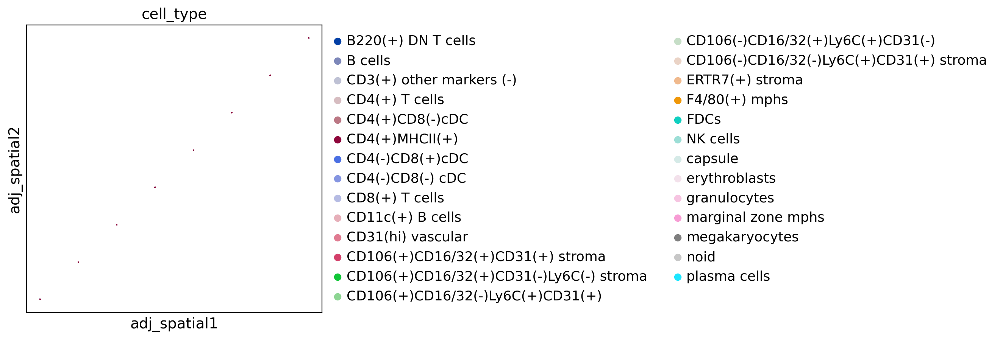

In [3]:
# Load data and offset
adata_path = dir_path + "/adata.h5ad"
adata = sc.read(adata_path) 

samples = [s for s in adata.obs['sample'].unique() if s != 'MRL-9']
adata_dict = {sample: adata[adata.obs['sample'] == sample].copy() for sample in samples}
adata_merged = merge_spatial_slices(adata_dict, x_offset=1e12, y_offset=1e12)
adata = adata_merged.copy()

sc.settings.set_figure_params(dpi=100, figsize=(5, 5)) 
sc.pl.embedding(adata_merged, basis='adj_spatial', color='cell_type', s=5)

In [4]:
seed = 42
set_seed(seed)

adata_int_path = dir_path + "/adata_processed_leiden08_8samples.h5ad"
if os.path.exists(adata_int_path):
    adata = sc.read_h5ad(adata_int_path)
else:
    adata = train_neighbor_weights(
        adata, 
        feature_emb='X', 
        spatial_emb='adj_spatial', 
        k=50, 
        spatial_w=1, 
        log_barrier_w=1e30, 
        sparisty_w=0.01,
        neighbor_weight=0.2, 
        num_epochs=10000, 
        cuda='cuda:2', 
        seed=seed, 
        batch=True, 
        batch_size=8192
    ) 
    print('Weight mean', adata.obs['Weight'].mean()) 
    sc.pp.neighbors(adata, use_rep='X_emb_smooth', random_state=seed) 
    sc.tl.leiden(adata, resolution=0.8, random_state=seed) 
    adata = spatial_smooth(adata, label_key='leiden', emb_key='X_emb_smooth', spatial_key='adj_spatial') 
    adata.write(adata_int_path) 

Training: 100%|██████████| 10000/10000 [11:43<00:00, 14.21epoch/s, Loss: 2290892334330490694081419698765824.0000]


Weight mean 0.49995103


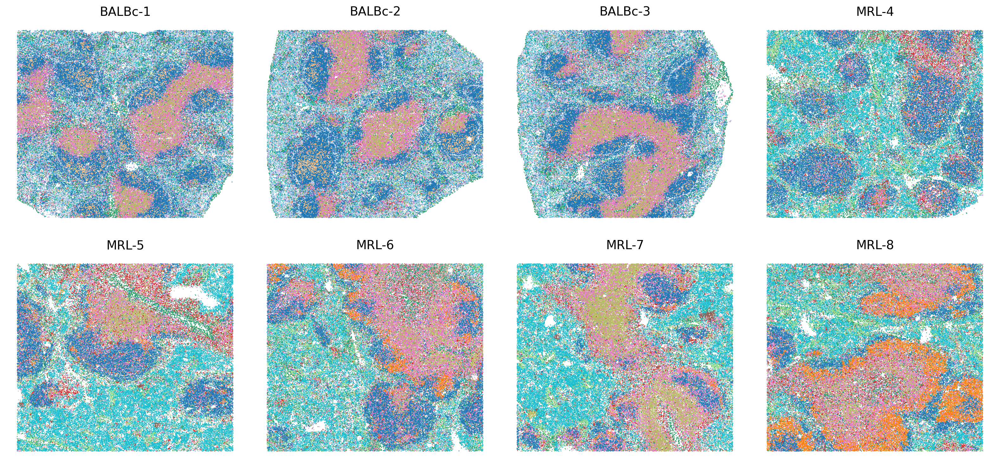

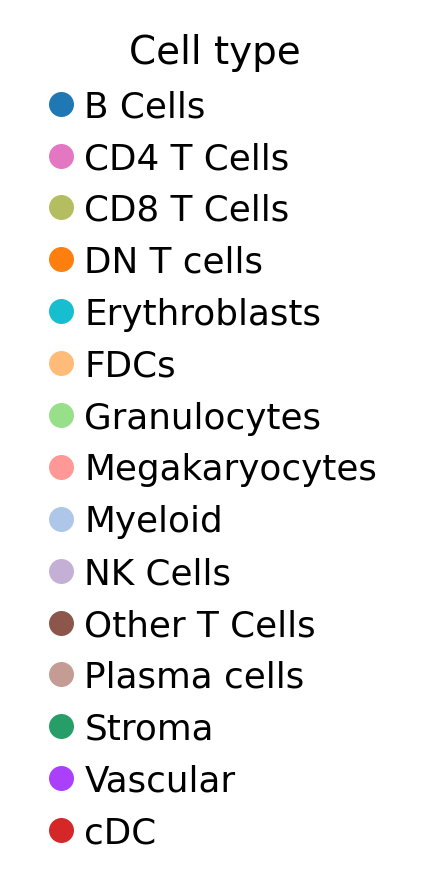

In [21]:
save_fig = True 
cluster_key = 'cell_type_merged'

celltype_merge_dict = {
    "CD11c(+) B cells": "B Cells",
    "B cells": "B Cells",
    "B220(+) DN T cells": "DN T cells",
    "CD106(-)CD16/32(-)Ly6C(+)CD31(+) stroma": "Stroma",
    "CD106(-)CD16/32(+)Ly6C(+)CD31(-)": "Stroma",
    "CD106(+)CD16/32(+)CD31(+) stroma": "Stroma",
    "CD106(+)CD16/32(-)Ly6C(+)CD31(+)": "Stroma",
    "CD106(+)CD16/32(+)CD31(-)Ly6C(-) stroma": "Stroma",
    "CD4(-)CD8(-) cDC": "cDC",
    "CD31(hi) vascular": "Vascular",
    "CD3(+) other markers (-)": "Other T Cells",
    "CD4(+) T cells": "CD4 T Cells",
    "CD4(+)CD8(-)cDC": "cDC",
    "CD8(+) T cells": "CD8 T Cells",
    "CD4(-)CD8(+)cDC": "cDC",
    "ERTR7(+) stroma": "Stroma",
    "erythroblasts": "Erythroblasts",
    "F4/80(+) mphs": "Myeloid",
    "FDCs": "FDCs",
    "granulocytes": "Granulocytes",
    "marginal zone mphs": "Myeloid",
    "megakaryocytes": "Megakaryocytes",
    "NK cells": "NK Cells",
    "capsule": "Stroma",
    "noid": "Stroma",
    "plasma cells": "Plasma cells",
    "CD4(+)MHCII(+)": "Other T Cells"
}
adata.obs[cluster_key] = adata.obs['cell_type'].map(celltype_merge_dict).fillna('Others')

sc.settings.set_figure_params(dpi=100, figsize=(5, 5))
cell_types_raw = adata.obs[cluster_key].unique()
cmaps = sc.pl.palettes.vega_20_scanpy
colors = [to_hex(cmaps[i]) for i in range(len(cell_types_raw))]
celltype_color_dict = dict(zip(cell_types_raw, colors))
missing_types = [ct for ct in cell_types_raw if ct not in celltype_color_dict]
if missing_types:
    additional_colors = sns.color_palette("tab20", len(missing_types)).as_hex()
    celltype_color_dict.update(dict(zip(missing_types, additional_colors)))
samples = adata.obs['sample'].unique().tolist()

nrows, ncols = 2, 4
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols * 4, nrows * 4))
axes = axes.flatten()
for i, sample in enumerate(samples):
    adata_sub = adata[adata.obs['sample'] == sample].copy()
    ax = axes[i]
    sc.pl.embedding(adata_sub, basis='adj_spatial', color=cluster_key, 
                    palette=celltype_color_dict, s=4, show=False, ax=ax, title=sample, legend_loc=None)
    for spine in ax.spines.values():
        spine.set_visible(False)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_xlabel("")
    ax.set_ylabel("")
for j in range(len(samples), len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout(rect=[0, 0.05, 1, 1], w_pad=1, h_pad=1)
fig_name = fig_path + 'figure3/fig3_s_codex_lymphnode_cell_type_combined_8samples.svg'
if save_fig:
    plt.savefig(fig_name, format="svg", bbox_inches="tight")
plt.show()

fig_legend, ax_legend = plt.subplots(figsize=(2.5, len(cell_types_raw) * 0.25))
legend_handles = [
    Line2D([0], [0], marker='o', color='w', markerfacecolor=celltype_color_dict[ct], markersize=10, label=ct)
    for ct in sorted(cell_types_raw)
]
ax_legend.legend(handles=legend_handles, title="Cell type", loc='center left', frameon=False)
ax_legend.axis('off')
legend_path = fig_path + 'figure3/fig3_s_codex_lymphnode_cell_type_combined_8samples_legend.svg'
if save_fig:
    plt.savefig(legend_path, format="svg", bbox_inches="tight")
plt.show()

In [6]:
region_id_merge_dict = {
    "0": "",
    "1": "",
    "2": "",
    "3": "",
    "4": "",
    "5": "",
    "6": "",
    "7": "",
    "8": "",
    "9": "",
    "10": "",
    "11": "",
    "12": "6",
    "13": "",
    "14": "",
    "15": "",
    "16": "",
    "17": "",
    "18": "",
    "19": "0",
    "20": "0",
    "21": "0",
    "22": "1",
    "23": "5",
    "24": "",
    "25": "",
    "26": "17",
    "27": "2",
    "28": "0",
    "29": "0",
    "30": "16",
    "31": "2",
    "32": "13",
    "33": "2",
    "34": "2",
    "35": "17",
    "36": "2",
    "37": "7",
    "38": "7",
    "39": "17",
    "40": "2",
    "41": "0"
}

region_key = "region_merged"
region_id_merge_dict = {k: (v if v != "" else k) for k, v in region_id_merge_dict.items()}
adata.obs[region_key] = adata.obs['region'].map(region_id_merge_dict).fillna('Others')
unique_clusters = sorted([c for c in adata.obs[region_key].unique() if c != 'Others'], key=lambda x: int(x))
cluster_id_dict = {old: str(i) for i, old in enumerate(unique_clusters)}
adata.obs[region_key] = adata.obs[region_key].map(lambda x: cluster_id_dict[x] if x in cluster_id_dict else x)

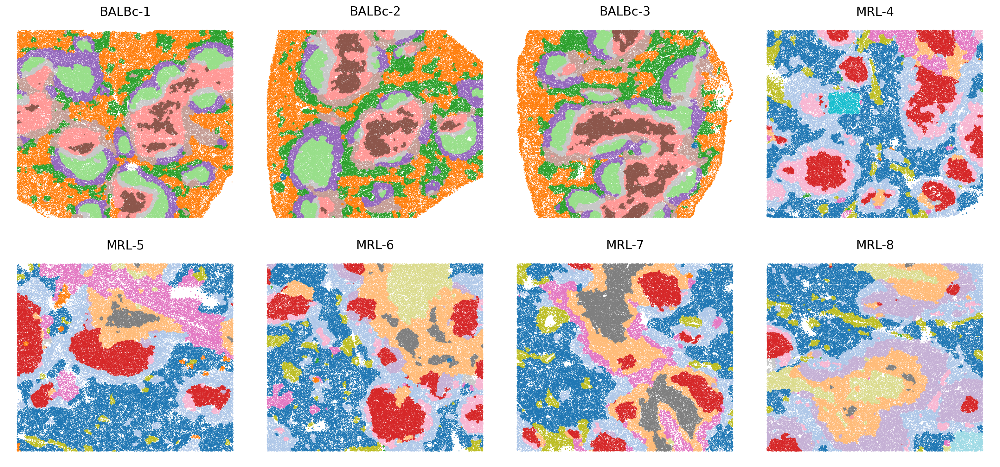

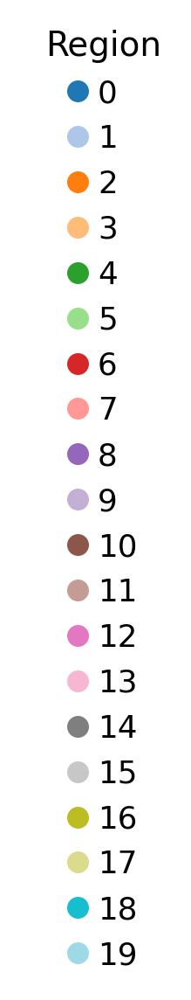

In [20]:
save_fig = True

sc.settings.set_figure_params(dpi=100, figsize=(5, 5))
regions_raw = adata.obs[region_key].unique()
def extract_number(s):
    match = re.search(r'\d+', str(s))
    return int(match.group()) if match else float('inf')
regions = sorted(regions_raw, key=extract_number)
cmaps = plt.get_cmap("tab20").colors + plt.get_cmap("tab20b").colors + plt.get_cmap("tab20c").colors
colors = [to_hex(cmaps[i % len(cmaps)]) for i in range(len(regions))]
region_color_dict = dict(zip(regions, colors))
samples = adata.obs['sample'].unique().tolist()
nrows, ncols = 2, 4
fig, axes = plt.subplots(nrows=nrows, ncols=ncols, figsize=(ncols * 4, nrows * 4))
axes = axes.flatten()
for i, sample in enumerate(samples):
    adata_sub = adata[adata.obs['sample'] == sample].copy()
    ax = axes[i]
    sc.pl.embedding(adata_sub, basis='adj_spatial', color=region_key, palette=region_color_dict, 
                    s=5, show=False, ax=ax, title=sample, legend_loc=None)
    for spine in ax.spines.values():
        spine.set_visible(False)
    ax.set_xticks([])
    ax.set_yticks([])
    ax.set_xlabel("")
    ax.set_ylabel("")
for j in range(len(samples), len(axes)):
    fig.delaxes(axes[j])
plt.tight_layout(rect=[0, 0.05, 1, 1], w_pad=1, h_pad=1)
fig_name = fig_path + 'figure3/fig3_s_codex_lymphnode_region_combined_8samples.svg'
if save_fig:
    plt.savefig(fig_name, format="svg", bbox_inches="tight")
plt.show()
# legend
fig_legend, ax_legend = plt.subplots(figsize=(1, len(regions) * 0.05))
legend_handles = [
    Line2D([0], [0], marker='o', color='w', markerfacecolor=region_color_dict[region], markersize=10, label=region)
    for region in regions
]
ax_legend.legend(handles=legend_handles, title="Region", loc='center left', frameon=False)
ax_legend.axis('off')
legend_path = fig_path + 'figure3/fig3_s_codex_lymphnode_region_combined_8samples_legend.svg'
if save_fig:
    plt.savefig(legend_path, format="svg", bbox_inches="tight")
plt.show()

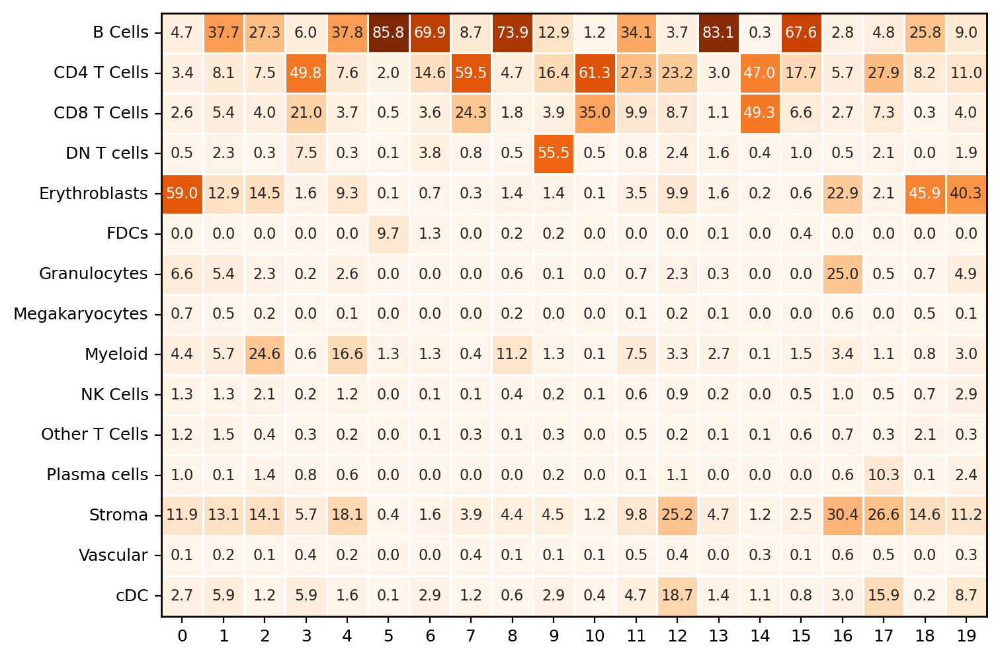

In [ ]:
count_matrix = (
    adata.obs.groupby([region_key, cluster_key])
    .size()
    .unstack(fill_value=0) 
)
percent_matrix = count_matrix.div(count_matrix.sum(axis=1), axis=0) * 100  

plt.figure(figsize=(8, 6))
ax = sns.heatmap(percent_matrix.T, cmap="Oranges", annot=True, fmt=".1f", linewidths=1, annot_kws={"size": 8}, cbar=False)
ax.set_xlabel("")
ax.set_ylabel("")
ax.tick_params(axis="x", labelsize=9)
ax.tick_params(axis="y", labelsize=9)
plt.grid(False) 
plt.title("")
for _, spine in ax.spines.items():
    spine.set_visible(True)  
    spine.set_linewidth(1) 
    spine.set_color("black") 
fig_name = fig_path + 'figure3/fig3_s_codex_lymphnode_combined_8samples_region_cluster_proportion.svg'
plt.savefig(fig_name, format="svg", bbox_inches="tight")
plt.show()